In [1]:
import nltk
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.io as pio
from plotly.offline import plot_mpl
import matplotlib.pyplot as plt
from pandas.core.common import flatten
from nltk import word_tokenize
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import ExtraTreesClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import matthews_corrcoef
from gensim.models import KeyedVectors
from gensim.models.word2vec import Word2Vec
from xgboost import XGBClassifier
from collections import Counter
from collections import defaultdict

plt.style.use('seaborn-paper')

In [2]:
news = pd.read_csv("news\indian_news_large.csv")
news["date"] = pd.to_datetime(news["news_date"])
news = news[news["news_category"] == "business"]
news = news[["date", "news_headline", "news_article"]]
news = news.groupby(['date'],as_index=False).agg({'news_headline': 'sum', "news_article": "sum"})
news.sort_values(by='date')

,date,news_headline,news_article
0,2013-06-25,IIM-Kozhikode: 54.29% women in new batchGoogle...,"IIM, Kozhikode's will have a record 54.29% of ..."
1,2013-06-26,Telecom operators slashing data charges'Amul' ...,Smartphone owners in India are in for a treat ...
2,2013-06-27,Samsung shares hit a 9-month low,Samsung Electronics shares slumped 3% to a nin...
3,2013-06-28,Cabinet approves doubling of Gas pricesGoogle ...,"Despite opposition, the Cabinet Committee on E..."
4,2013-06-29,BlackBerry's share price dropped by 25%Petrol ...,BlackBerry's share price dropped by 25% in pre...
...,...,...,...
2416,2020-03-04,India's services sector growth hits over 7-yea...,India's services sector activity expanded for ...
2417,2020-03-05,Yes Bank customers cannot withdraw more than ₹...,The government has placed India's fifth-larges...
2418,2020-03-06,"SBI to invest at least ₹12,000 crore in Yes Ba...",The RBI has released a draft reconstruction sc...
2419,2020-03-07,"PhonePe switches to ICICI for UPI, @ybl handle...",PhonePe restored UPI facilities late Friday ni...


In [3]:
# Get data from http://www.mecklai.com/Digital/MecklaiData/HistoryData_OHLC?AspxAutoDetectCookieSupport=1
fx = pd.read_csv("forex/Currency_Data_EURUSD.csv", index_col=False)
fx.columns = ["currecny", "date", "Open", "High", "Low", "Close"]
fx["date"] = pd.to_datetime(fx["date"])
fx.sort_values(by='date', inplace=True)
fx.reset_index(drop=True, inplace=True)
fx["label"] = fx["Close"].diff(periods=1)
fx.dropna(inplace=True)
fx.drop("currecny", axis=1, inplace=True)
fx["label"] = fx["label"].map(lambda x: 1 if float(x)>=0 else 0)
fx

,date,Open,High,Low,Close,label
1,2007-01-10,1.4232,1.4238,1.4140,1.4155,1
2,2007-01-11,1.4488,1.4488,1.4405,1.4425,1
3,2007-02-08,1.3669,1.3705,1.3652,1.3704,0
4,2007-02-11,1.4425,1.4528,1.4416,1.4504,1
5,2007-03-08,1.3703,1.3819,1.3684,1.3774,0
...,...,...,...,...,...,...
3096,2020-10-02,1.0951,1.0958,1.0909,1.0910,0
3097,2020-11-02,1.0910,1.0925,1.0892,1.0922,1
3098,2020-11-03,1.1316,1.1367,1.1258,1.1285,1
3099,2020-12-02,1.0922,1.0926,1.0877,1.0879,0


In [4]:
news_and_fx = pd.merge(news, fx, on=["date"])
news_and_fx.set_index('date', inplace=True)
news_and_fx["headline_len"] = news_and_fx["news_headline"].map(len)
news_and_fx["article_len"] = news_and_fx["news_article"].map(len)
print(Counter(news_and_fx["label"]))
news_and_fx

Counter({0: 816, 1: 784})


,news_headline,news_article,Open,High,Low,Close,label,headline_len,article_len
date,,,,,,,,,
2013-06-25,IIM-Kozhikode: 54.29% women in new batchGoogle...,"IIM, Kozhikode's will have a record 54.29% of ...",1.3120,1.3151,1.3065,1.3077,0,158,1501
2013-06-26,Telecom operators slashing data charges'Amul' ...,Smartphone owners in India are in for a treat ...,1.3077,1.3087,1.2985,1.3012,0,139,1274
2013-06-27,Samsung shares hit a 9-month low,Samsung Electronics shares slumped 3% to a nin...,1.3012,1.3057,1.3000,1.3038,1,32,247
2013-06-28,Cabinet approves doubling of Gas pricesGoogle ...,"Despite opposition, the Cabinet Committee on E...",1.3038,1.3103,1.2991,1.3010,0,199,1962
2013-07-01,Rupee worst among Asian currency in Q1Many B-s...,The rupee lost as much as 8.6% in the April-Ju...,1.3075,1.3120,1.3017,1.3117,1,106,1030
...,...,...,...,...,...,...,...,...,...
2020-02-28,"Investors lose ₹11 lakh cr in 6 sessions, Sens...",Sensex registered its worst week since 2009 sl...,1.0980,1.1053,1.0951,1.1026,1,917,4625
2020-03-01,"Apple sends iPads, face masks to employees str...",Apple has sent 'care packages' to its employee...,1.1170,1.1180,1.1125,1.1161,1,452,2513
2020-03-02,Sensex ends 153 points lower as govt confirms ...,Sensex gave up all gains and closed 153 points...,1.1084,1.1096,1.1036,1.1059,0,465,2440


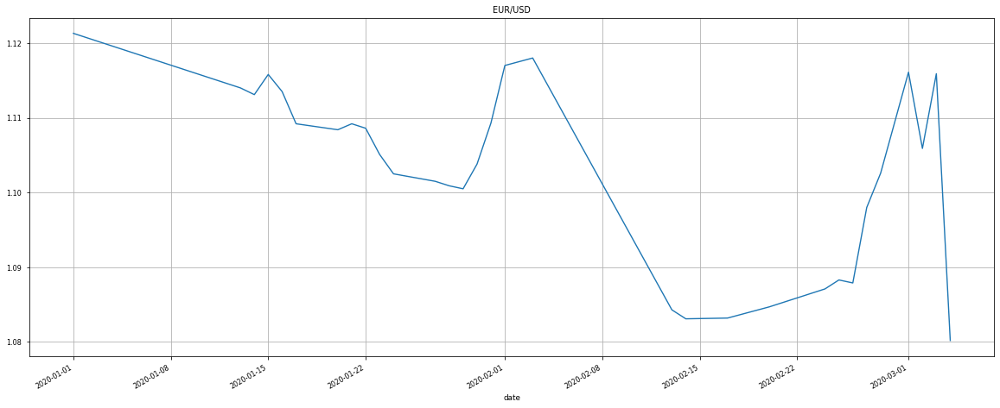

In [5]:
news_and_fx.loc["2020-01-01":]["Close"].plot(figsize=(20, 8), title="EUR/USD", grid=True)

In [6]:
fig = px.histogram(news_and_fx, 
                   x="headline_len", 
                   color="label", 
                   marginal="rug", 
                   hover_data=news_and_fx.columns, 
                   color_discrete_sequence=px.colors.sequential.Sunsetdark)
fig.update_layout(
    title_text='Headline Sentence Length Distribution', 
    xaxis_title_text='Daily Sentence Length', 
    yaxis_title_text='Count'
)
fig.show()
fig.write_image(file=r"C:\Users\YangWang\Desktop\currecy_prediction\image\Headline Sentence Length Distribution.png")

In [7]:
fig = px.histogram(news_and_fx, 
                   x="article_len", 
                   color="label", 
                   marginal="rug", 
                   hover_data=news_and_fx.columns, 
                   color_discrete_sequence=px.colors.sequential.Sunsetdark)
fig.update_layout(
    title_text='Article Sentence Length Distribution', 
    xaxis_title_text='Daily Sentence Length', 
    yaxis_title_text='Count'
)
fig.show()
fig.write_image(file=r"C:\Users\YangWang\Desktop\currecy_prediction\image\Article Sentence Length Distribution.png")

In [8]:
train = news_and_fx.loc[:"2019-03-07"]
test = news_and_fx.loc["2019-03-08":]

In [9]:
print(Counter(train["label"]))
train

Counter({0: 694, 1: 681})


,news_headline,news_article,Open,High,Low,Close,label,headline_len,article_len
date,,,,,,,,,
2013-06-25,IIM-Kozhikode: 54.29% women in new batchGoogle...,"IIM, Kozhikode's will have a record 54.29% of ...",1.3120,1.3151,1.3065,1.3077,0,158,1501
2013-06-26,Telecom operators slashing data charges'Amul' ...,Smartphone owners in India are in for a treat ...,1.3077,1.3087,1.2985,1.3012,0,139,1274
2013-06-27,Samsung shares hit a 9-month low,Samsung Electronics shares slumped 3% to a nin...,1.3012,1.3057,1.3000,1.3038,1,32,247
2013-06-28,Cabinet approves doubling of Gas pricesGoogle ...,"Despite opposition, the Cabinet Committee on E...",1.3038,1.3103,1.2991,1.3010,0,199,1962
2013-07-01,Rupee worst among Asian currency in Q1Many B-s...,The rupee lost as much as 8.6% in the April-Ju...,1.3075,1.3120,1.3017,1.3117,1,106,1030
...,...,...,...,...,...,...,...,...,...
2019-03-01,"Children can exit Aadhaar on turning 18, Cabin...",The Cabinet on Thursday approved the promulgat...,1.1335,1.1411,1.1309,1.1399,1,552,3300
2019-03-04,"Jet Airways grounds 2 more planes, 20% fleet n...",Cash-strapped Jet Airways on Monday said it ha...,1.1197,1.1255,1.1192,1.1244,0,1111,6707
2019-03-05,I plan to end preferential trade status given ...,US President Donald Trump has said he intends ...,1.1178,1.1205,1.1135,1.1198,0,1146,7002


In [10]:
print(Counter(test["label"]))
test

Counter({0: 122, 1: 103})


,news_headline,news_article,Open,High,Low,Close,label,headline_len,article_len
date,,,,,,,,,
2019-03-09,PM Modi hai toh mumkin hai: Congress on Nirav ...,After 'The Telegraph' released a video on Satu...,1.0974,1.0979,1.0926,1.0970,0,1143,6568
2019-03-10,State govt approves setting up two IT parks in...,The Goa government has approved setting up two...,1.0958,1.0999,1.0941,1.0983,1,925,5524
2019-03-12,Godrej Properties presents homes with 5-tier s...,"With child-safe homes, RFID enabled complex, 2...",1.1075,1.1094,1.1066,1.1088,1,1568,9541
2019-03-13,Wipro's Azim Premji raises contribution to cha...,Wipro Chairman Azim Premji has earmarked all e...,1.1290,1.1315,1.1277,1.1303,1,1459,8630
2019-03-14,Will burn Chinese goods on Mar 19 to teach a l...,Traders' body CAIT and RSS' economic wing Swad...,1.1303,1.1339,1.1294,1.1299,0,1207,7295
...,...,...,...,...,...,...,...,...,...
2020-02-28,"Investors lose ₹11 lakh cr in 6 sessions, Sens...",Sensex registered its worst week since 2009 sl...,1.0980,1.1053,1.0951,1.1026,1,917,4625
2020-03-01,"Apple sends iPads, face masks to employees str...",Apple has sent 'care packages' to its employee...,1.1170,1.1180,1.1125,1.1161,1,452,2513
2020-03-02,Sensex ends 153 points lower as govt confirms ...,Sensex gave up all gains and closed 153 points...,1.1084,1.1096,1.1036,1.1059,0,465,2440


In [11]:
def clean_text(text):
    tokens_list = word_tokenize(text)
    tokens_list = [word for word in tokens_list if word.isalpha()]
    tokens_list = [w for w in tokens_list if not w in stopwords.words('english')]
    return tokens_list

In [12]:
class Word2VecVectorizer:
    def __init__(self):
        # Load in pretrained word vectors from https://github.com/Kyubyong/wordvectors
        print("Loading in word vectors...")
        self.w2v = KeyedVectors.load_word2vec_format(
            r"F:\embedding_file\GoogleNews-vectors-negative300.bin", binary=True)
        self.word2vec = {w: vec for w, vec in zip(self.w2v.wv.index2word, self.w2v.wv.vectors)}
        print("Finished loading in word vectors.")
        
    def fit(self, data):
        pass
    
    def transform(self, data):
        # Dimension of feature
        self.D = self.w2v.wv.vector_size
        
        # Convert sentences using bag of word
        X = np.zeros((len(data), self.D))
        n = 0
        emptycount = 0
        for sentence in data:
            # First, remove stopwords and emoji. Second, tokenise sentence using mecab.
            tokens = clean_text(sentence)
            vecs = []
            m = 0
            for word in tokens:
                try: 
                    vec = self.w2v.wv.get_vector(word)
                    vecs.append(vec)
                    m += 1
                except KeyError:
                    pass
            if len(vecs) > 0:
                vecs = np.array(vecs)
                X[n] = vecs.mean(axis=0)
            else:
                emptycount += 1
            n += 1
        print("Number of samples with no words found: %s / %s" % (emptycount, len(data)))
        return X
    
    def fit_transform(self, data):
        self.fit(data)
        return self.transform(data)

In [13]:
# Reference from https://www.kaggle.com/mohanamurali/bgow-tf-idf-lr-w2v-lgb-bayesopt
class TfidfWord2VecVectorizer:
    def __init__(self):
        # Load in pretrained word vectors from https://github.com/Kyubyong/wordvectors
        print("Loading in word vectors...")
        self.w2v = KeyedVectors.load_word2vec_format(
            r"F:\embedding_file\GoogleNews-vectors-negative300.bin", binary=True)
        self.word2vec = {w: vec for w, vec in zip(self.w2v.wv.index2word, self.w2v.wv.vectors)}
        self.word2weight = None
        self.dim = self.w2v.wv.vector_size
        print("Finished loading in word vectors.")
        
    def fit(self, X, y):
        tfidf = TfidfVectorizer(analyzer=lambda x: x)
        tfidf.fit(X)
        max_idf = max(tfidf.idf_)
        self.word2weight = defaultdict(
            lambda: max_idf,
            [(w, tfidf.idf_[i]) for w, i in tfidf.vocabulary_.items()])

        return self
    
    def transform(self, X):
        return np.array([
                np.mean([self.word2vec[w] * self.word2weight[w]
                         for w in words if w in self.word2vec] or
                        [np.zeros(self.dim)], axis=0)
                for words in X
            ])

In [14]:
def performance(model, x_train, y_train, x_test, y_test):
    print("test accuracy: ", round(model.score(x_test, y_test), 4))
    print("f-beta score: ", round(f1_score(y_test, model.predict(x_test)), 4))
    print("roc auc score: ", round(roc_auc_score(y_test, model.predict(x_test)), 4))
    print("matthews corrcoef: ", round(matthews_corrcoef(y_test, model.predict(x_test)), 4))
    print("confusion matrix: \n", confusion_matrix(y_test, model.predict(x_test)))

In [ ]:
# If using TfidfWord2VecVectorizer(), then set it to True. Instead, set it to False.
weighted = True
# If using news headline as training data, then set it to True. Instead, set it to False.
using_headline = True

if weighted:
    if using_headline:
        print("Using TfidfWord2VecVectorizer.\n")
        vectorizer = TfidfWord2VecVectorizer()
        vectorizer.fit(train["news_headline"], train.label)
        x_train = vectorizer.transform(train.news_headline)
        y_train = train.label
        x_test = vectorizer.transform(test.news_headline)
        y_test = test.label
        print("\n# of train data: {}\n# of features: {}\n".format(x_train.shape[0], x_train.shape[1]))
        print("\n# of test data: {}\n# of features: {}\n".format(x_test.shape[0], x_test.shape[1]))
        print("Training data: \n", x_train)
    else:
        print("Using TfidfWord2VecVectorizer.\n")
        vectorizer = TfidfWord2VecVectorizer()
        vectorizer.fit(train["news_article"], train.label)
        x_train = vectorizer.transform(train.news_article)
        y_train = train.label
        x_test = vectorizer.transform(test.news_article)
        y_test = test.label
        print("\n# of train data: {}\n# of features: {}\n".format(x_train.shape[0], x_train.shape[1]))
        print("\n# of test data: {}\n# of features: {}\n".format(x_test.shape[0], x_test.shape[1]))
        print("Training data: \n", x_train)
else: 
    if using_headline:
        print("Using Word2VecVectorizer.\n")
        vectorizer = Word2VecVectorizer()
        x_train = vectorizer.fit_transform(train.news_headline)
        y_train = train.label
        x_test = vectorizer.fit_transform(test.news_headline)
        y_test = test.label
        print("\n# of train data: {}\n# of features: {}\n".format(x_train.shape[0], x_train.shape[1]))
        print("\n# of test data: {}\n# of features: {}\n".format(x_test.shape[0], x_test.shape[1]))
        print("Training data: \n", x_train)
    else: 
        print("Using Word2VecVectorizer.\n")
        vectorizer = Word2VecVectorizer()
        x_train = vectorizer.fit_transform(train.news_article)
        y_train = train.label
        x_test = vectorizer.fit_transform(test.news_article)
        y_test = test.label
        print("\n# of train data: {}\n# of features: {}\n".format(x_train.shape[0], x_train.shape[1]))
        print("\n# of test data: {}\n# of features: {}\n".format(x_test.shape[0], x_test.shape[1]))
        print("Training data: \n", x_train)

Using TfidfWord2VecVectorizer.

Loading in word vectors...


In [ ]:
xgb = XGBClassifier(
    learning_rate=0.01,  
    n_estimators=400, 
    random_state=17, 
    slient = 0)

params = { 
    'min_child_weight': [1, 5, 10],
    'gamma': [0.5, 1, 1.5, 2, 5],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'max_depth': [5, 10, 15, 20]
}

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=17)

random_search = RandomizedSearchCV(
    xgb, 
    param_distributions=params, 
    n_iter=param_comb, 
    scoring='roc_auc', 
    n_jobs=6, 
    cv=skf.split(x_train, y_train), 
    verbose=2, 
    random_state=17)
random_search.fit(x_train, y_train)
xgb = random_search.best_estimator_
performance(xgb, x_train, y_train, x_test, y_test)

In [ ]:
etc = ExtraTreesClassifier(
    criterion='gini', 
    random_state=17)

params = { 
    'n_estimators': [100, 200, 300]
}

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=17)

random_search = RandomizedSearchCV(
    etc, 
    param_distributions=params, 
    n_iter=param_comb, 
    scoring='roc_auc', 
    n_jobs=6, 
    cv=skf.split(x_train, y_train), 
    verbose=2, 
    random_state=17)
random_search.fit(x_train, y_train)
etc = random_search.best_estimator_
performance(etc, x_train, y_train, x_test, y_test)

In [ ]:
rfc = RandomForestClassifier(
    n_estimators=200, 
    random_state=17)

params = { 
    'n_estimators': [100, 200, 300]
}

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=17)

random_search = RandomizedSearchCV(
    rfc, 
    param_distributions=params, 
    n_iter=param_comb, 
    scoring='roc_auc', 
    n_jobs=6, 
    cv=skf.split(x_train, y_train), 
    verbose=2, 
    random_state=17)
random_search.fit(x_train, y_train)
rfc = random_search.best_estimator_
performance(rfc, x_train, y_train, x_test, y_test)

In [ ]:
dtc = DecisionTreeClassifier(
    criterion='gini', 
    random_state=17)

params = { 
    'max_depth': [5, 10, 15, 20, 25, 30]
}

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=17)

random_search = RandomizedSearchCV(
    dtc, 
    param_distributions=params, 
    n_iter=param_comb, 
    scoring='roc_auc', 
    n_jobs=6, 
    cv=skf.split(x_train, y_train), 
    verbose=2, 
    random_state=17)
random_search.fit(x_train, y_train)
dtc = random_search.best_estimator_
performance(dtc, x_train, y_train, x_test, y_test)

In [ ]:
knn = KNeighborsClassifier(
    metric="minkowski")

params = { 
    'n_neighbors': [6, 8, 10, 12], 
    "leaf_size": [25, 30, 35]
}

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=17)

random_search = RandomizedSearchCV(
    knn, 
    param_distributions=params, 
    n_iter=param_comb, 
    scoring='roc_auc', 
    n_jobs=6, 
    cv=skf.split(x_train, y_train), 
    verbose=2, 
    random_state=17)
random_search.fit(x_train, y_train)
knn = random_search.best_estimator_
performance(knn, x_train, y_train, x_test, y_test)

In [ ]:
ada = AdaBoostClassifier(
    random_state=17)

params = { 
    'n_estimators': [25, 50, 75, 100], 
    "learning_rate": [1, 0.1, 0.01, 0.001]
}

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=17)

random_search = RandomizedSearchCV(
    ada, 
    param_distributions=params, 
    n_iter=param_comb, 
    scoring='roc_auc', 
    n_jobs=6, 
    cv=skf.split(x_train, y_train), 
    verbose=2, 
    random_state=17)
random_search.fit(x_train, y_train)
ada = random_search.best_estimator_
performance(ada, x_train, y_train, x_test, y_test)

In [ ]:
eclf = VotingClassifier(
    estimators=[('rfc', rfc), ('etc', etc), ('dtc', dtc), ('knn', knn)],
    voting='soft')
eclf.fit(x_train, y_train)
performance(eclf, x_train, y_train, x_test, y_test)